# SUAN Pharma data preparation and exploration

## Problem statement:
We are analyzing the data generated from various sensors with in four steps of production of API (Active Pharmaceutical Ingredient).

![Production process](img/batch_process.png)

## Goal:
We are tasked to identify to the variables which increase the yield of the API at the end of the production process. Over the years through iterative improvements, it is said that the yield has been increased. This project could hopefully help in pin-pointing the exact variables and quantify their effects on the yield.

## Data:
We are provided with data collected for each batch executed during the past 9-10 months. For each batch there exists a time-series data of one minute intervals and a static value for the percentage of the yield generated at the end of the batch.

## Challenges:
1. The process is sequential, so is the data collected during the process. For example, when the first step starts the data collection is limited to the first step and maybe the second step as well at some point during the end of the first step, this means that out of the four steps atmost two steps could be active at any given point resulting in nan or 

### Data preparation:
1. For each batch an Excel file containing five sheets is shared each of which can be briefly described as follows:
    1. PO: It contains 3 values, the batch ID, the start and the end times of the batch.
    2. BHV: Data collected from Broth Harvest step is in this sheet, it contains 19 columns
    3. CFF: Data collected from Cross Flow Filtration step is in this sheet, it contains 114 columns
    4. EXT: Data collected from Extraction step is in this sheet, it contains 78 columns
    5. NF: Data collected from Nano Filtration step is in this sheet, it contains 53 columns
2. Firstly all the data from various steps needs to be column binded and then various batches of data needs to be row binded.
###### udf.read_bind() takes care of Steps 1 and 2 among other simple tasks such as object to datetime conversion etc.
3. One thing to note is that sometimes the time variable in the timeseries is occasionally shared in a different format than what is expected by the above function, this has to be taken care of manually
4. Handling bool variables by converting them to 0s and 1s


In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as st
import plotly.express as px
import matplotlib.pyplot as plt
pd.set_option('display.float_format', lambda x: '%.5f' % x)

from tqdm import tqdm
import glob
import sys  
sys.path.insert(0, '../src')

# importing user-defined functions from udf_eda.py
import udf_eda as udf
import udf_timeseries as udf_ts

In [2]:
file_names = glob.glob('../../../data/input/11_Dataset/**/ODP *.xlsx')

In [3]:
len(file_names)

40

In [4]:
df = udf.read_bind(file_names)

# if any blank columns are created by accident in a spreadsheet software, which wouldn't have any column name, we remove such columns
df = df[df.columns.drop(list(df.filter(regex='Unnamed:')))]
print("How many NaN values exist in the data: ", df.isna().sum().sum())
print("Shape of the data: ",df.shape)

100%|██████████| 40/40 [02:09<00:00,  3.23s/it]


The following batches have incompatible data:  ['1778', '1576']
# of batches read:  36
Missing batches, if any: {'1573', '1777'}
How many NaN values exist in the data:  0
Shape of the data:  (47319, 265)


Lets read the file containing the yield values:

In [5]:
df = df[df.id != '1510']
print("How many NaN values exist in the data: ", df.isna().sum().sum())
print("Shape of the data: ",df.shape)

How many NaN values exist in the data:  0
Shape of the data:  (47319, 265)


In [6]:
# Extracting the Resa variable from produzione_CStOA_2021_ed12.xlsx
tdf = pd.read_excel('../../../data/input/11_Dataset/produzione_CStOA_2021_ed12.xlsx', sheet_name="dati-produzione", header=1)
tdf = tdf[['O.D.P.','Resa']]
tdf.dropna(axis=0, how='any', inplace=True)
tdf['O.D.P.'] =tdf['O.D.P.'].astype(int).astype(str).str[-4:]
tdf.columns = ['id', 'result']
tdf.result = round(tdf.result,3)
df = tdf.merge(df, how='inner')

In [7]:
tdf = df.groupby(['id'])['timeseries'].agg(['min', 'max']).reset_index()
tdf.columns = ['id', 'start_date', 'end_date']
tdf['processing_time_mins'] = ((tdf['end_date'] - tdf['start_date'])/pd.Timedelta(minutes = 1))+1
df = tdf.merge(df, how = 'right')
df.insert(5, 'timestamp_index', df.groupby('id').cumcount())

In [8]:
df[['id', 'start_date', 'end_date', 'processing_time_mins', 'result']].drop_duplicates().reset_index(drop =True)

,id,start_date,end_date,processing_time_mins,result
0,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400
1,1574,2021-08-18 19:30:00,2021-08-19 19:09:00,1420.00000,0.74000
2,1575,2021-08-20 00:00:00,2021-08-21 02:29:00,1590.00000,0.75800
3,1577,2021-08-22 20:40:00,2021-08-23 18:29:00,1310.00000,0.73300
4,1578,2021-08-23 22:50:00,2021-08-24 21:09:00,1340.00000,0.72500
5,1579,2021-08-25 00:22:00,2021-08-25 22:29:00,1328.00000,0.70300
6,1580,2021-08-26 15:14:00,2021-08-27 11:29:00,1216.00000,0.75400
7,1581,2021-08-27 17:02:00,2021-08-28 11:39:00,1118.00000,0.74100
8,1582,2021-08-28 16:34:00,2021-08-29 21:29:00,1736.00000,0.76700
9,1583,2021-08-30 01:03:00,2021-08-30 23:29:00,1347.00000,0.76400


The 1st and 99th percentile of column df['DIAFTOTALE'] is [-0.0034383377374990823, 2.228056874225769]. So, it is safe to set the lower and upper bounds for this columns as [-1,+3]

In [9]:
# for i in range(0, 101, 1):    
#     print(df['DIAFTOTALE'].quantile(i/1000))
df.loc[df['DIAFTOTALE'] > 3, 'DIAFTOTALE'] = 2.59
df.loc[df['DIAFTOTALE'] < -1, 'DIAFTOTALE'] = -0.4

Lets compute mean and mean CI for each batch

In [10]:
batch_id = list(df['id'].unique())
VOI_mean = ['101LI636', 'DIAFTOTALE', '107LI606', '113LI682']
lst = []

for i in batch_id:
    for j in VOI_mean:
        data = df.loc[df['id'] == i, j]
        #create 95% confidence interval for t distribution and normal distribution population mean
        x = st.t.interval(alpha=0.95, df=len(data)-1, loc=np.mean(data), scale=st.sem(data))
        y = st.norm.interval(alpha=0.95, loc=np.mean(data), scale=st.sem(data))
        lst.append([i, j, np.mean(data), x[0], x[1], y[0], y[1]])
data = pd.DataFrame(lst, columns= ['batch_id', 'variable', 'mean', 't_dist_mean_lcb', 't_dist_mean_ucb', 'norm_dist_mean_lcb', 'norm_dist_mean_ucb'])


### TASK:
The data generated from the following cell needs to be plotted to visualize if some batches are out of pattern

In [11]:
for i in VOI_mean:
    print("Lets take a look at mean distributions from all batches for variable: ", i)
    display(data.loc[data['variable'] == i].reset_index(drop=True))

Lets take a look at mean distributions from all batches for variable:  101LI636


,batch_id,variable,mean,t_dist_mean_lcb,t_dist_mean_ucb,norm_dist_mean_lcb,norm_dist_mean_ucb
0,1572,101LI636,58062.70010,56262.31391,59863.08629,56263.87822,59861.52197
1,1574,101LI636,66418.65533,65035.76093,67801.54972,65036.94048,67800.37017
2,1575,101LI636,58052.95372,56284.66877,59821.23867,56286.01568,59819.89176
3,1577,101LI636,79453.16679,78706.93265,80199.40093,78707.62265,80198.71094
4,1578,101LI636,77208.10429,76169.82693,78246.38166,76170.76544,78245.44314
5,1579,101LI636,59873.05979,58102.30075,61643.81883,58103.91584,61642.20373
6,1580,101LI636,60249.14480,58518.40035,61979.88925,58520.12446,61978.16513
7,1581,101LI636,56078.07959,54248.78323,57907.37595,54250.76539,57905.39379
8,1582,101LI636,48883.48662,47245.64297,50521.33026,47246.78554,50520.18769
9,1583,101LI636,52773.88119,50877.99719,54669.76520,50879.70200,54668.06039


Lets take a look at mean distributions from all batches for variable:  DIAFTOTALE


,batch_id,variable,mean,t_dist_mean_lcb,t_dist_mean_ucb,norm_dist_mean_lcb,norm_dist_mean_ucb
0,1572,DIAFTOTALE,1.48742,1.45567,1.51918,1.45569,1.51915
1,1574,DIAFTOTALE,1.61954,1.59074,1.64833,1.59076,1.64831
2,1575,DIAFTOTALE,1.35417,1.32306,1.38528,1.32309,1.38526
3,1577,DIAFTOTALE,1.50940,1.47991,1.53889,1.47994,1.53886
4,1578,DIAFTOTALE,1.50737,1.47545,1.53929,1.47548,1.53926
5,1579,DIAFTOTALE,1.57781,1.54917,1.60645,1.54919,1.60642
6,1580,DIAFTOTALE,1.63889,1.60806,1.66972,1.60809,1.66969
7,1581,DIAFTOTALE,1.59220,1.55907,1.62534,1.55911,1.62530
8,1582,DIAFTOTALE,1.16228,1.12155,1.20301,1.12158,1.20298
9,1583,DIAFTOTALE,1.39633,1.35976,1.43289,1.35980,1.43285


Lets take a look at mean distributions from all batches for variable:  107LI606


,batch_id,variable,mean,t_dist_mean_lcb,t_dist_mean_ucb,norm_dist_mean_lcb,norm_dist_mean_ucb
0,1572,107LI606,15.86725,15.30089,16.43360,15.30138,16.43311
1,1574,107LI606,14.71150,14.24169,15.18131,14.24209,15.18091
2,1575,107LI606,34.21311,33.19667,35.22954,33.19744,35.22877
3,1577,107LI606,24.19987,23.54581,24.85393,23.54641,24.85333
4,1578,107LI606,14.14113,13.81450,14.46777,13.81479,14.46747
5,1579,107LI606,12.74015,12.43993,13.04037,12.44021,13.04009
6,1580,107LI606,8.55386,8.34829,8.75944,8.34850,8.75923
7,1581,107LI606,13.95756,13.67765,14.23748,13.67795,14.23717
8,1582,107LI606,10.51893,9.97970,11.05816,9.98007,11.05778
9,1583,107LI606,24.00390,23.19434,24.81347,23.19507,24.81274


Lets take a look at mean distributions from all batches for variable:  113LI682


,batch_id,variable,mean,t_dist_mean_lcb,t_dist_mean_ucb,norm_dist_mean_lcb,norm_dist_mean_ucb
0,1572,113LI682,17.87364,17.62574,18.12155,17.62595,18.12133
1,1574,113LI682,20.40690,20.11840,20.69539,20.11865,20.69515
2,1575,113LI682,19.25799,19.01694,19.49904,19.01713,19.49885
3,1577,113LI682,18.65639,18.37424,18.93855,18.37450,18.93829
4,1578,113LI682,18.96014,18.67167,19.24862,18.67193,19.24836
5,1579,113LI682,19.00882,18.71711,19.30054,18.71738,19.30027
6,1580,113LI682,19.81293,19.47892,20.14694,19.47925,20.14660
7,1581,113LI682,19.05155,18.72953,19.37358,18.72988,19.37323
8,1582,113LI682,19.02642,18.83021,19.22262,18.83035,19.22248
9,1583,113LI682,24.99370,24.51355,25.47384,24.51399,25.47341


### POSSIBLE WARNING:
The cells which are using the plotly library may not show the plots in a vanilla jupyter-notebook (in browser)

In [12]:
for i in VOI_mean:
    fig = px.line(df, x="timestamp_index", y=i, color='id', hover_data=["result"])
    fig.show()

As per the guidelines document, the start and end of each step in the process can be identified using the above 4 variables,
1. DIAFTOTALE will be used to identify when the CFF process completes, also considering all the batches its distribution is almost constant.
2. 107LI606 is for NF, notice that the distributions for each batch are not consistent as the values increase. It is said that the process starts when the values jump from 0 to a certain value quickly, which can be identified from the plot above.
3. 113LI682 is for EXT

In [13]:
for i in VOI_mean:
    fig = px.box(df, x="id", y= i, points='all')
    fig.update_xaxes(type='category')
    fig.show()

Lets take a look at udf.ecdfs for the 4 variables above:

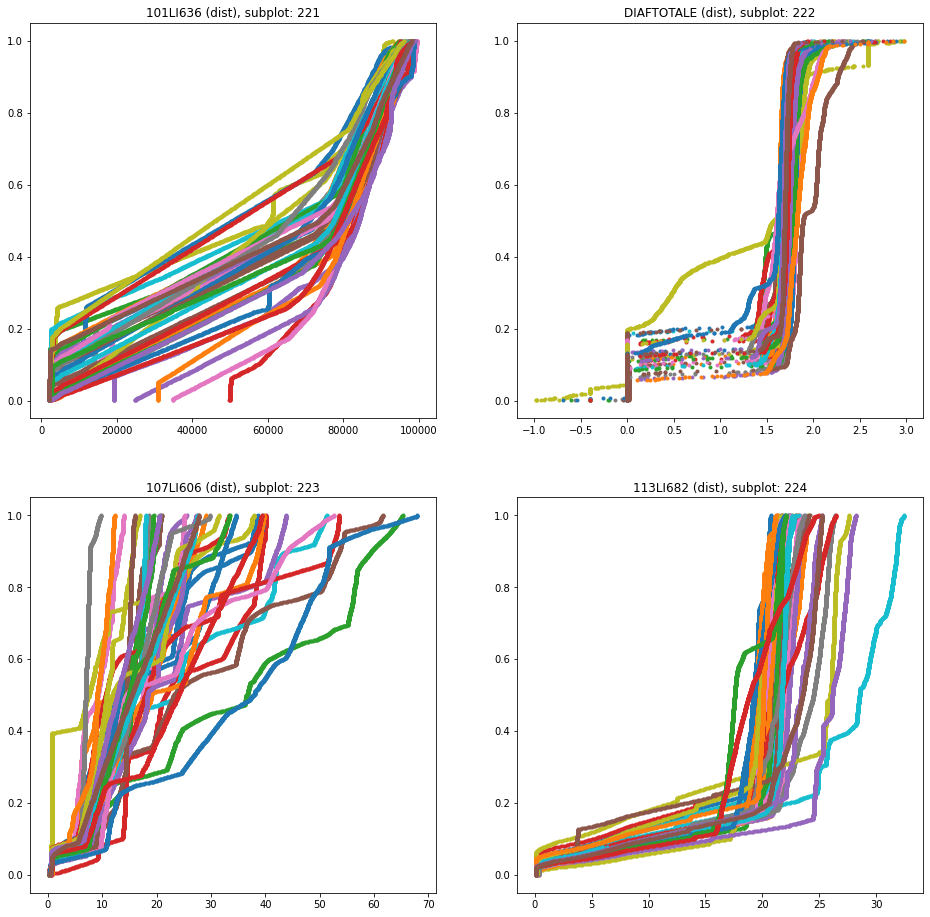

In [14]:
import math

a = 2  # number of rows
b = 2  # number of columns
fig = plt.figure(figsize=(16,16))

for i in batch_id:
    c = 1  # initialize plot counter
    for j in VOI_mean:
        plt.subplot(a, b, c)
        plt.title('{} (dist), subplot: {}{}{}'.format(j, a, b, c))
        # if condition to treat 'DIAFTOTALE' variable outliers
        x, y = udf.ecdf(df.loc[df['id'] == i, j])
        plt.scatter(x = x, y = y, linewidths= 1, marker='.')
        c = c+1

In [15]:
col_irregularities = df.nunique()[df.nunique()<=2].keys()
for i in col_irregularities:
    print("Column {col_} has just these values: {list_}".format(col_=i, list_=df[i].unique()))
# lets remove columns with constant values
# df.drop(columns = col_irregularities.values, inplace= True)

Column 158PIC678_823 has just these values: [0.]
Column 118ZLH303 has just these values: [False  True]
Column 118LS960 has just these values: [False  True]
Column 118LS690 has just these values: [False  True]
Column 118ZLL417 has just these values: [False  True]
Column 118ZLL427 has just these values: [False  True]
Column 118ZLL437 has just these values: [False  True]
Column 118ZLL447 has just these values: [False  True]
Column 118FI913 has just these values: [32000]


In the above output we can see 4 variables with Device type abbrevation as "ZLL" which is not mentioned in the guideline document shared with the team, even if we consider 118Z to be the unit number, there is no LL abbrevation. We may need more data to take a call on whether to remove variables which have one unique values apart from nan (there are 3 such variables above). Anyways for now bool variables are converted to int/float by converting them to 0s and 1s.

In [16]:
cols_BHV = ['101LI636', '101WI610', '306LI606', '101AI635', '101AI605', '101TI607', '101TI637', '306TI604', '306LI606', '158PI678', '101PI602', '101PI603', '158PIC678_823', '158PIC678_824', '99TI620', '99PI621', '99AI622', '99AI623', '99AI624']
cols_CFF = ['158FI652', '158FI654', '158FI656', '158FI666', '158FI667', '158FI679P', '158PI651', '158PI653', '158PI655', '158PI663', '158PI678', '158TI650', '158TIC650', '159FI652', '159FI654', '159FI656', '159FI666', '159FI667', '159PI651', '159PI653', '159PI655', '159PI663', '159TI650', '159TIC650', '160FI652', '160FI654', '160FI656', '160FI666', '160FI667', '160PI651', '160PI653', '160PI655', '160PI663', '160TI650', '160TIC650', '161FI652', '161FI654', '161FI656', '161FI666', '161FI667', '161PI651', '161PI653', '161PI655', '161PI663', '161TI650', '161TIC650', '162FI652', '162FI654', '162FI656', '162FI666', '162FI667', '162PI651', '162PI653', '162PI655', '162PI663', '162TI650', '162TIC650', '163FI652', '163FI654', '163FI656', '163FI666', '163FI667', '163PI651', '163PI653', '163PI655', '163PI663', '163TI650', '163TIC650', '164FI652', '164FI654', '164FI656', '164FI666', '164FI667', '164PI651', '164PI653', '164PI655', '164PI663', '164TI650', '164TIC650', '165FI652', '165FI654', '165FI656', '165FI666', '165FI667', '165PI651', '165PI653', '165PI655', '165PI663', '165TI650', '165TIC650', '158CAL4551', '158CAL4552', '159CAL4551', '159CAL4552', '160CAL4551', '160CAL4552', '161CAL4551', '161CAL4552', '162CAL4551', '162CAL4552', '163CAL4551', '163CAL4552', '164CAL4551', '164CAL4552', '165CAL4551', '165CAL4552', 'DWTOTALE', 'PERMTOTALE', 'DIAFTOTALE', 'CONCTOTALE', '158TI684', '158TI670', '158TI672', '158TI673']
cols_NF = ['107LI606', '107TI607', '107PI608', '107AI610', '107TI652', '107TI656', '107TI660', '107TI664', '107TI668', '107PI650', '107PI651', '107PI654', '107PI655', '107PI658', '107PI659', '107PI682A', '107PI684A', '107PI686A', '107PI688A', '107PI690A', '107PI692A', '107FI681A', '107FI696A', '107FI685A', '107FI689A', '107FI693A', '107AI672', '108AI610', '107AI673A', '107AI674A', '107AI677A', '108AI611', '108AI612', '108AI613', '108TI652', '108TI656', '108TI660', '108TI664', '108PI650', '108PI651', '108PI654', '108PI655', '108PI658', '108PI659', '108PI662', '108PI663', '108FI653', '108FI657', '108FI665', '108FI669', '108FI673', '108FI677', '108FI681']
cols_EXT = ['118PI619', '118PI618', '118PI914', '118PI950', '118PI954', '118PI915', '118PI916', '118PI917', '118TI609', '118TI970', '118TI971', '118TI972', '118TI973', '118TI977', '118TI978', '118EI610', '118EI620', '118EI630', '118EI640', '118SI613', '118SI623', '118SI633', '118SI643', '118FI983', '118FI638', '118AI611', '118AI621', '118AI631', '118AI641', '118AI627', '118AI616', '118FI602', '118FI601', '118FI602', '109LI606', '109FI616', '118FI982', '118FI606', '118FIC606', '118CV502', '118CV501', '890PI610', '118FQ602', '118ZLH303', '118LS960', '118LS690', '118ZLL417', '118ZLL427', '118ZLL437', '118ZLL447', '118FI912', '118FI913', '118PI629', '118PI628', '118PI924', '118PI951', '118PI964', '118PI925', '118PI926', '118PI927', '118PI639', '118PI638', '118PI934', '118PI952', '118PI974', '118PI935', '118PI936', '118PI937', '118PI649', '118PI648', '118PI944', '118PI953', '118PI984', '118PI945', '118PI946', '118PI947', '113LI682', '113LI682']

In [17]:
print(df.columns)
print(len(cols_BHV) + len(cols_CFF) + len(cols_NF) + len(cols_EXT))

Index(['id', 'start_date', 'end_date', 'processing_time_mins', 'result',
       'timestamp_index', 'timeseries', '101LI636', '101WI610', '306LI606',
       ...
       '108PI659', '108PI662', '108PI663', '108FI653', '108FI657', '108FI665',
       '108FI669', '108FI673', '108FI677', '108FI681'],
      dtype='object', length=270)
264


In [18]:
udf.describe(df[col_irregularities]).T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max,dtype,size,perc_null
158PIC678_823,47319.00000,NaN,NaN,NaN,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,float64,47319,0.00000
118ZLH303,47319,2,False,45559,NaN,NaN,NaN,NaN,NaN,NaN,NaN,bool,47319,0.00000
118LS960,47319,2,False,47312,NaN,NaN,NaN,NaN,NaN,NaN,NaN,bool,47319,0.00000
118LS690,47319,2,False,47167,NaN,NaN,NaN,NaN,NaN,NaN,NaN,bool,47319,0.00000
118ZLL417,47319,2,False,39784,NaN,NaN,NaN,NaN,NaN,NaN,NaN,bool,47319,0.00000
118ZLL427,47319,2,False,38441,NaN,NaN,NaN,NaN,NaN,NaN,NaN,bool,47319,0.00000
118ZLL437,47319,2,False,38934,NaN,NaN,NaN,NaN,NaN,NaN,NaN,bool,47319,0.00000
118ZLL447,47319,2,False,40421,NaN,NaN,NaN,NaN,NaN,NaN,NaN,bool,47319,0.00000
118FI913,47319.00000,NaN,NaN,NaN,32000.00000,0.00000,32000.00000,32000.00000,32000.00000,32000.00000,32000.00000,int64,47319,0.00000


In [19]:
describe_df = udf.describe(df).T
describe_df.loc[describe_df['dtype'] == 'bool'].index

Index(['118ZLH303', '118LS960', '118LS690', '118ZLL417', '118ZLL427',
       '118ZLL437', '118ZLL447'],
      dtype='object')

What do the above bool variables mean?

In [20]:
x_df = df[df.columns.drop('timestamp_index')].groupby(['id', 'start_date', 'end_date', 'processing_time_mins', 'result']).describe()
x_df.columns = ['_'.join(col).strip() for col in x_df.columns.values]
x_df.reset_index(inplace=True)
x_df = x_df[x_df.columns.drop(list(x_df.filter(regex='_count')))]

In [21]:
x_df

,id,start_date,end_date,processing_time_mins,result,101LI636_mean,101LI636_std,101LI636_min,101LI636_25%,101LI636_50%,...,108FI677_50%,108FI677_75%,108FI677_max,108FI681_mean,108FI681_std,108FI681_min,108FI681_25%,108FI681_50%,108FI681_75%,108FI681_max
0,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,58062.70010,34266.63481,2260.07129,24109.16309,73949.92578,...,0.11042,0.52341,7.88942,0.09631,0.00872,0.06643,0.09025,0.09621,0.10219,0.12322
1,1574,2021-08-18 19:30:00,2021-08-19 19:09:00,1420.00000,0.74000,66418.65533,26565.28647,2265.06567,48698.20703,77434.46875,...,0.11177,0.77659,7.56835,0.09425,0.00805,0.06874,0.08879,0.09400,0.09976,0.12028
2,1575,2021-08-20 00:00:00,2021-08-21 02:29:00,1590.00000,0.75800,58052.95372,35947.75662,2225.23291,18892.07471,78651.13281,...,0.41814,0.92974,4.68558,0.59415,0.92202,0.07351,0.09497,0.10410,0.85125,9.40296
3,1577,2021-08-22 20:40:00,2021-08-23 18:29:00,1310.00000,0.73300,79453.16679,13767.68498,49830.66016,70895.72656,82802.39844,...,0.10935,0.29655,6.53273,0.09896,0.00688,0.07597,0.09447,0.09900,0.10382,0.12005
4,1578,2021-08-23 22:50:00,2021-08-24 21:09:00,1340.00000,0.72500,77208.10429,19374.25228,24928.99023,70975.05273,83299.42578,...,0.10803,0.51143,3.52357,0.26086,0.68544,0.07599,0.09155,0.09698,0.10223,4.37224
5,1579,2021-08-25 00:22:00,2021-08-25 22:29:00,1328.00000,0.70300,59873.05979,32893.80523,2184.48804,30402.57861,75788.41016,...,0.10504,0.10752,0.11763,0.09647,0.00691,0.07162,0.09186,0.09648,0.10099,0.11799
6,1580,2021-08-26 15:14:00,2021-08-27 11:29:00,1216.00000,0.75400,60249.14480,30762.29961,2204.01123,29510.52051,75179.45312,...,0.90855,0.96269,3.25338,0.09742,0.00698,0.07509,0.09267,0.09770,0.10199,0.12093
7,1581,2021-08-27 17:02:00,2021-08-28 11:39:00,1118.00000,0.74100,56078.07959,31173.53401,2330.40430,23111.10107,65981.83203,...,0.80554,0.88094,3.00794,0.09592,0.00689,0.07582,0.09141,0.09586,0.10056,0.12307
8,1582,2021-08-28 16:34:00,2021-08-29 21:29:00,1736.00000,0.76700,48883.48662,34793.34125,2372.76758,4170.15076,60350.71484,...,0.10816,0.89770,5.76714,0.09299,0.00791,0.06849,0.08765,0.09297,0.09835,0.11730
9,1583,2021-08-30 01:03:00,2021-08-30 23:29:00,1347.00000,0.76400,52773.88119,35469.63901,2328.97754,12082.66357,63668.35156,...,0.10636,0.74121,6.48327,0.22790,0.69766,0.06974,0.08759,0.09281,0.09829,11.24099


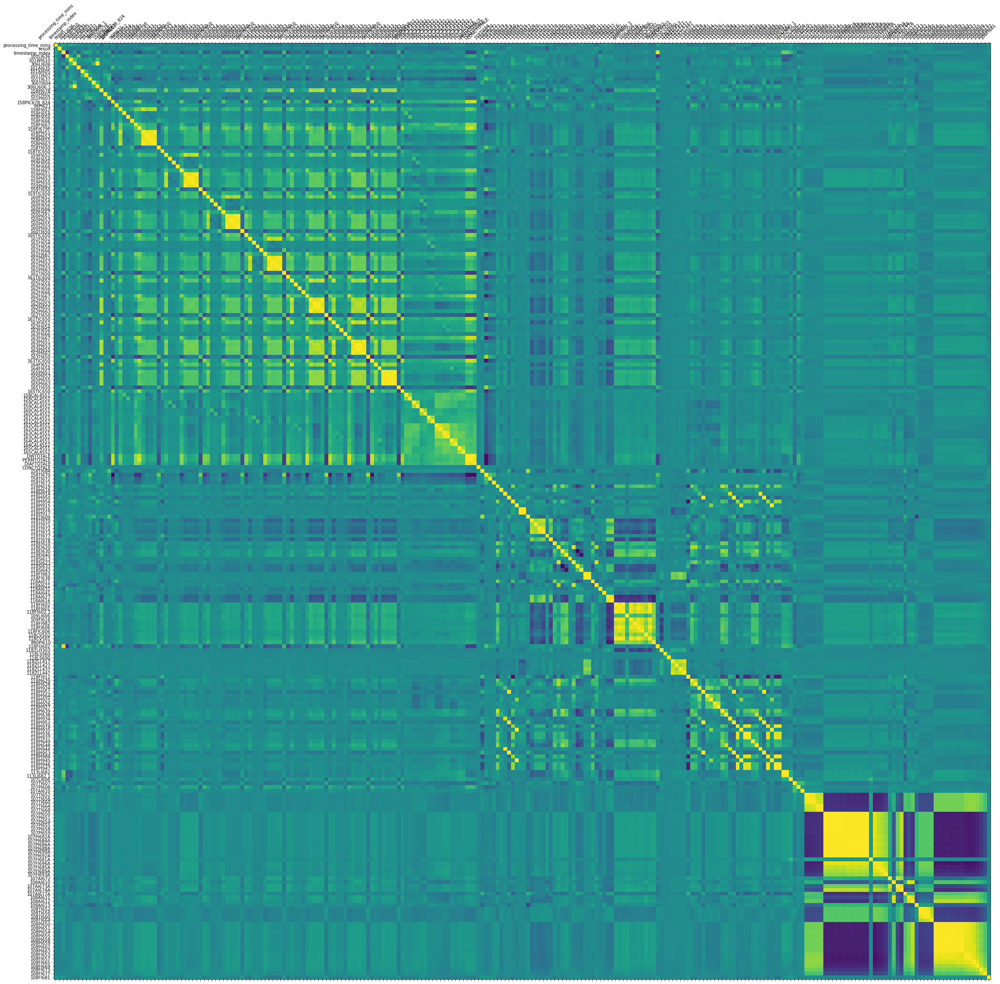

In [22]:
udf.plot_corr(df, 40)

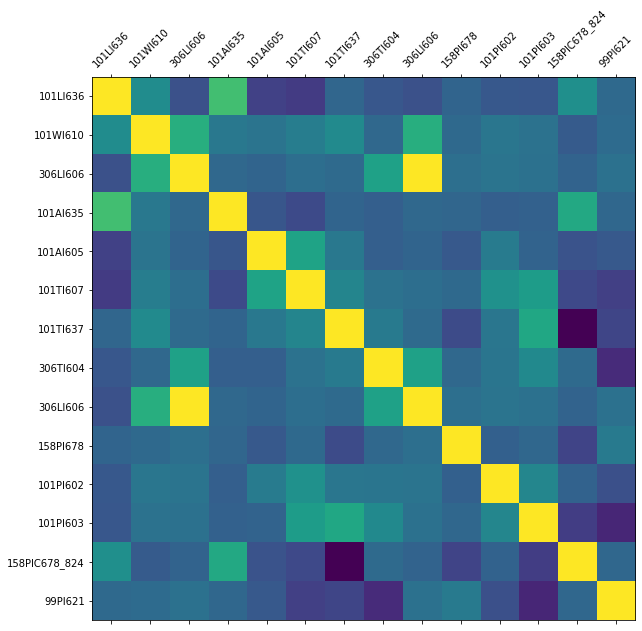

In [23]:
# cols_BHV = [x for x in cols_BHV if (x not in col_irregularities)]
udf.plot_corr(df[cols_BHV])

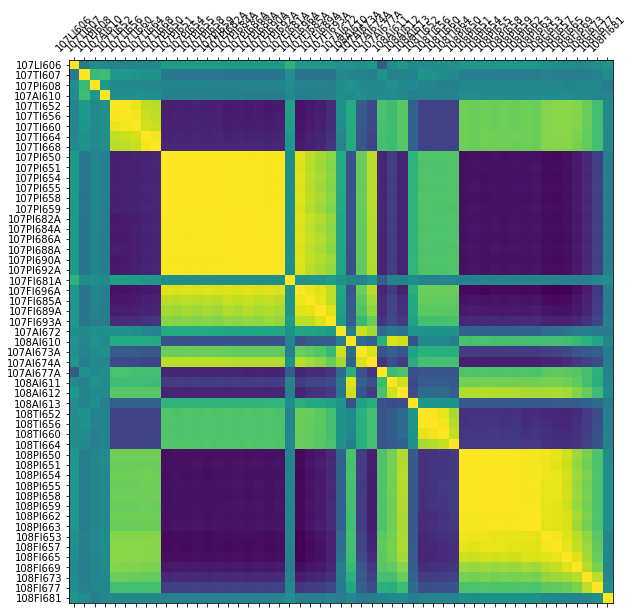

In [24]:
udf.plot_corr(df[cols_NF])

Removing variables with strong correlations

In [25]:
# 0.9 - 82
# 0.8 - 118
# 0.7 - 132
df_7 = udf.eliminate_corr(df,thresh = 0.7)

# of columns before dropping correlated variables:  270
# of columns to drop 132
Dropped columns after correlation analysis: ['306LI606.1', '158PI651', '158PI653', '158PI655', '158PI663', '159PI651', '159PI653', '159PI655', '159PI663', '160PI651', '160PI653', '160PI655', '160PI663', '161PI651', '161PI653', '161PI655', '161PI663', '162FI652', '162FI667', '162PI651', '162PI653', '162PI655', '162PI663', '162TIC650', '163FI652', '163FI667', '163PI651', '163PI653', '163PI655', '163PI663', '163TI650', '163TIC650', '164FI652', '165PI651', '165PI653', '165PI655', '165PI663', '165TIC650', '159CAL4552', '161CAL4552', '162CAL4552', '163CAL4551', '163CAL4552', '164CAL4552', '165CAL4552', 'DWTOTALE', 'PERMTOTALE', 'DIAFTOTALE', '158TI670', '118PI917', '118TI609', '118TI972', '118TI973', '118SI623', '118SI633', '118SI643', '118FI638', '118AI621', '118AI616', '118FI601', '118FI602.1', '109FI616', '118FI982', '118FI606', '118FIC606', '118CV502', '118CV501', '890PI610', '118FQ602', '118ZLL427', '118ZLL

In [26]:
df.shape

(47319, 270)

In [27]:
df

,id,start_date,end_date,processing_time_mins,result,timestamp_index,timeseries,101LI636,101WI610,306LI606,...,108PI659,108PI662,108PI663,108FI653,108FI657,108FI665,108FI669,108FI673,108FI677,108FI681
0,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,0,2021-08-16 14:16:00,96254.11719,17828.50781,0.00000,...,0.17681,-0.03637,0.08378,0.08873,0.09937,0.08581,0.08367,0.11416,0.11452,0.10423
1,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,1,2021-08-16 14:17:00,96065.36719,17975.73242,0.00000,...,0.18066,-0.03374,0.08563,0.10814,0.09720,0.08634,0.09276,0.11443,0.11576,0.11590
2,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,2,2021-08-16 14:18:00,96171.63281,18128.39062,0.00000,...,0.17937,-0.03743,0.07904,0.02183,0.09590,0.08634,0.08402,0.10539,0.10479,0.09779
3,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,3,2021-08-16 14:19:00,96244.42188,18211.97461,0.00000,...,0.17534,-0.03854,0.08728,0.08360,0.09708,0.08803,0.08715,0.11048,0.10751,0.08934
4,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,4,2021-08-16 14:20:00,96036.05469,18238.95703,0.00000,...,0.17328,-0.04109,0.08374,0.06481,0.09999,0.08325,0.08621,0.11352,0.10912,0.10429
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47314,1949,2021-10-04 03:20:00,2021-10-05 00:59:00,1300.00000,0.75900,1295,2021-10-05 00:55:00,2231.38086,1426.05713,0.00000,...,0.16151,-0.04031,0.09843,0.04526,0.09306,0.08371,0.08335,0.10280,0.10907,0.09397
47315,1949,2021-10-04 03:20:00,2021-10-05 00:59:00,1300.00000,0.75900,1296,2021-10-05 00:56:00,2231.68579,1436.05176,0.00000,...,0.16558,-0.04496,0.09614,0.12657,0.09976,0.07932,0.07267,0.11036,0.09884,0.09824
47316,1949,2021-10-04 03:20:00,2021-10-05 00:59:00,1300.00000,0.75900,1297,2021-10-05 00:57:00,2235.42993,1425.38989,0.00000,...,0.16743,-0.03034,0.09093,0.09325,0.09936,0.07983,0.08169,0.10508,0.10837,0.10906
47317,1949,2021-10-04 03:20:00,2021-10-05 00:59:00,1300.00000,0.75900,1298,2021-10-05 00:58:00,2250.75171,1432.30359,0.00000,...,0.16743,-0.04386,0.09612,0.13265,0.09834,0.08014,0.08567,0.10680,0.10603,0.10089


Lets create a few new variables:

In [28]:
# df.drop(columns=['progress_perc'],inplace=True)
# Insert the progress column which measures progress in percentage terms
df.insert(6, 'progress_perc', round(((df.timestamp_index / df.processing_time_mins)*100),0).astype(int))

In [31]:
df_7.insert(6, 'progress_perc', round(((df_7.timestamp_index / df_7.processing_time_mins)*100),0).astype(int))

In [53]:
df_7.columns

Index(['id', 'start_date', 'end_date', 'processing_time_mins', 'result',
       'timestamp_index', 'progress_perc', 'timeseries', '101LI636',
       '101WI610',
       ...
       '107AI610', '107TI652', '107PI650', '107FI681A', '107AI672', '108AI610',
       '107AI677A', '108AI613', '108TI652', '108FI681'],
      dtype='object', length=139)

In [57]:
df_std= df_7.groupby(
            ['id', 'start_date', 'end_date', 'processing_time_mins', 'result', 'progress_perc']
            )[df_7.columns[8:].tolist()].mean().reset_index()

In [52]:
df_7.columns[8:].tolist()

['101LI636',
 '101WI610',
 '306LI606',
 '101AI635',
 '101AI605',
 '101TI607',
 '101TI637',
 '306TI604',
 '158PI678',
 '101PI602',
 '101PI603',
 '158PIC678_823',
 '158PIC678_824',
 '99TI620',
 '99PI621',
 '99AI622',
 '99AI623',
 '99AI624',
 '158FI652',
 '158FI654',
 '158FI656',
 '158FI666',
 '158FI667',
 '158FI679P',
 '158TI650',
 '158TIC650',
 '159FI652',
 '159FI654',
 '159FI656',
 '159FI666',
 '159FI667',
 '159TI650',
 '159TIC650',
 '160FI652',
 '160FI654',
 '160FI656',
 '160FI666',
 '160FI667',
 '160TI650',
 '160TIC650',
 '161FI652',
 '161FI654',
 '161FI656',
 '161FI666',
 '161FI667',
 '161TI650',
 '161TIC650',
 '162FI654',
 '162FI656',
 '162FI666',
 '162TI650',
 '163FI654',
 '163FI656',
 '163FI666',
 '164FI654',
 '164FI656',
 '164FI666',
 '164FI667',
 '164PI651',
 '164PI653',
 '164PI655',
 '164PI663',
 '164TI650',
 '164TIC650',
 '165FI652',
 '165FI654',
 '165FI656',
 '165FI666',
 '165FI667',
 '165TI650',
 '158CAL4551',
 '158CAL4552',
 '159CAL4551',
 '160CAL4551',
 '160CAL4552',
 '16

In [48]:
display(df_7.groupby(['id'])['timestamp_index'].max().describe())

count     36.00000
mean    1313.41667
std      205.45008
min      904.00000
25%     1203.25000
50%     1323.00000
75%     1399.50000
max     1735.00000
Name: timestamp_index, dtype: float64

In [58]:
df_std

,id,start_date,end_date,processing_time_mins,result,progress_perc,101LI636,101WI610,306LI606,101AI635,...,107AI610,107TI652,107PI650,107FI681A,107AI672,108AI610,107AI677A,108AI613,108TI652,108FI681
0,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,0,96078.99777,18136.58398,0.00000,5.21474,...,8.31327,19.43655,0.19066,39.90525,0.00980,9.16779,0.02026,0.15964,23.81236,0.10329
1,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,1,94233.98717,18376.60714,0.00000,5.14035,...,6.93781,19.75081,0.18778,39.90525,0.00930,9.17105,0.02013,0.15882,23.82477,0.10072
2,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,2,91640.58929,19033.82129,0.00000,5.15450,...,5.06670,18.82890,4.78566,1759.23195,0.92411,9.16024,0.01907,0.15829,23.85027,0.10467
3,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,3,89616.18359,19300.67746,0.00000,5.17017,...,5.07136,15.41243,9.55239,2150.39896,2.77182,9.16089,0.01699,0.15760,23.88763,0.10453
4,1572,2021-08-16 14:16:00,2021-08-17 13:29:00,1394.00000,0.76400,4,87651.74665,20394.41253,0.00000,5.11466,...,5.07528,14.00907,11.51786,2092.68229,3.83891,9.17166,0.01537,0.15718,23.92775,0.10319
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3631,1949,2021-10-04 03:20:00,2021-10-05 00:59:00,1300.00000,0.75900,96,2147.50017,1436.28600,0.00000,3.66908,...,4.73674,20.53515,2.71718,5738.07520,3.97162,9.46286,-0.00226,0.17852,22.03046,0.09735
3632,1949,2021-10-04 03:20:00,2021-10-05 00:59:00,1300.00000,0.75900,97,2171.54314,1436.14417,0.00000,3.69113,...,4.42327,40.46828,7.67689,10651.87583,10.13971,9.47245,-0.00106,0.17782,22.03977,0.10003
3633,1949,2021-10-04 03:20:00,2021-10-05 00:59:00,1300.00000,0.75900,98,2192.02930,1437.75439,0.00000,3.71110,...,5.64344,41.46387,3.75644,10698.88815,9.98288,9.47692,-0.00074,0.17807,22.05472,0.09627
3634,1949,2021-10-04 03:20:00,2021-10-05 00:59:00,1300.00000,0.75900,99,2222.30615,1435.66209,0.00000,3.73083,...,6.28505,40.68239,2.87978,10684.64814,9.78141,9.47135,-0.00050,0.17808,22.05866,0.10090


/Users/nageshk/PycharmProjects/SUAN/ai-challenge-suanfarma/nagesh_kommuri/notebooks/../src/udf_timeseries.py:24: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



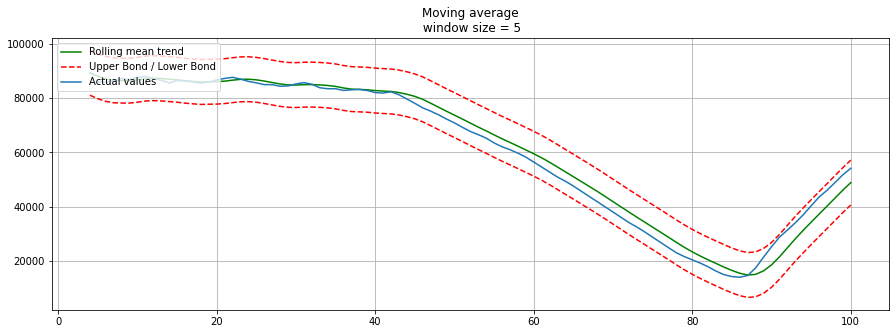

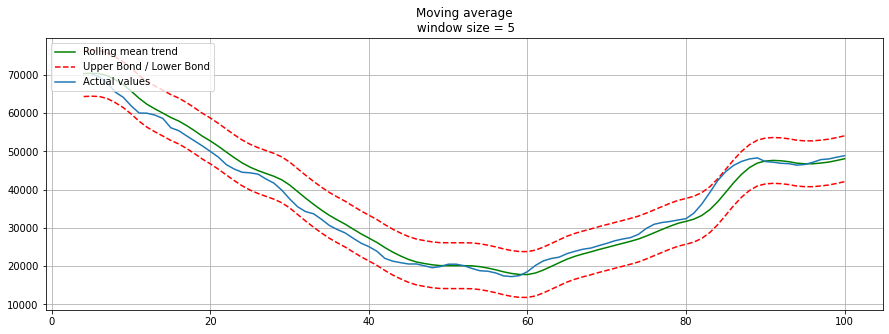

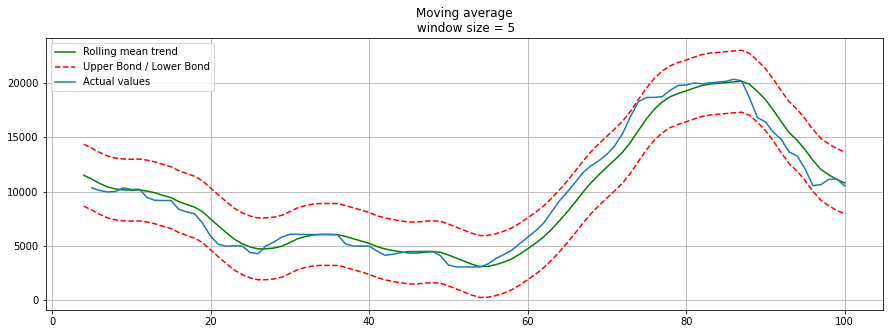

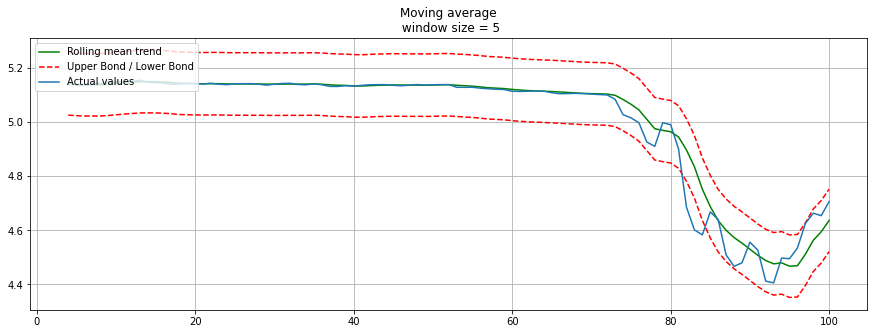

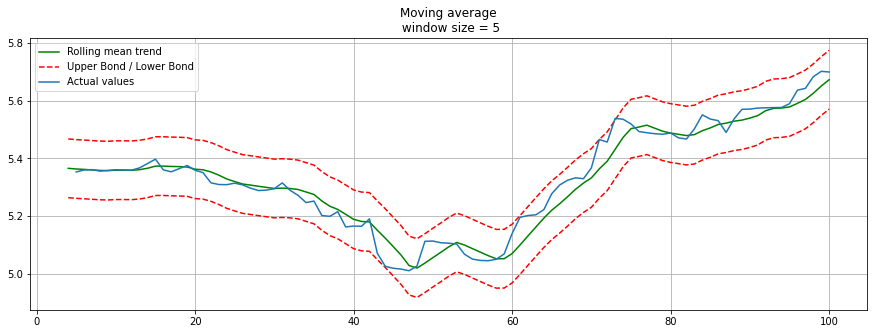

...

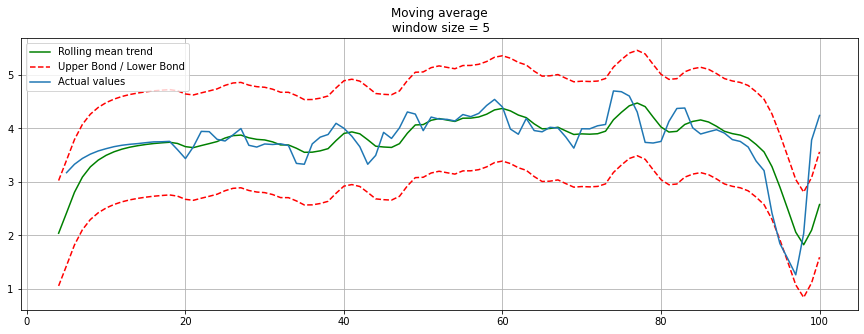

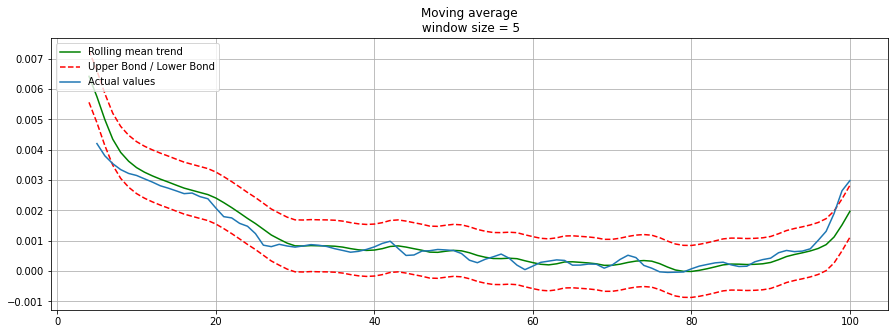

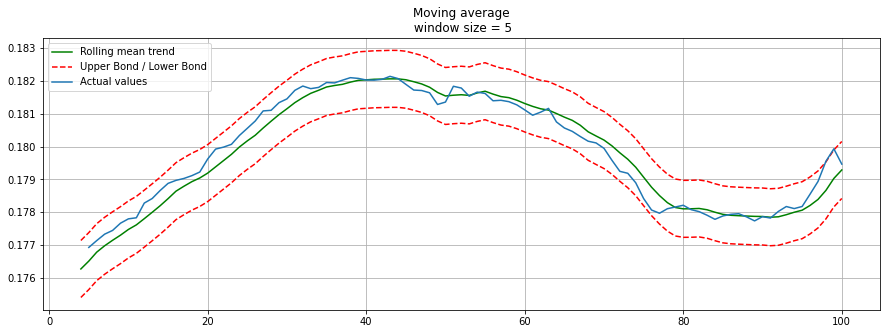

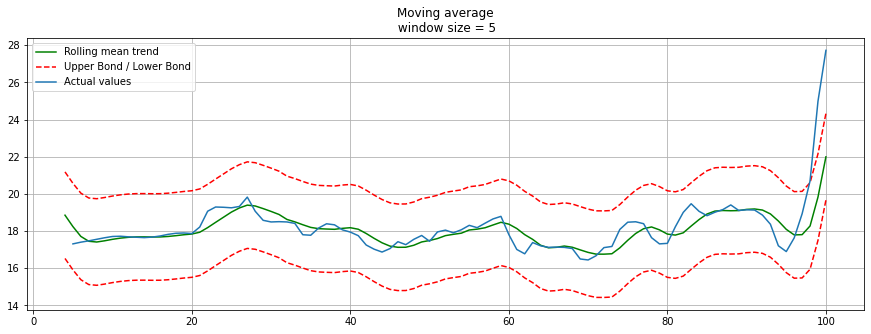

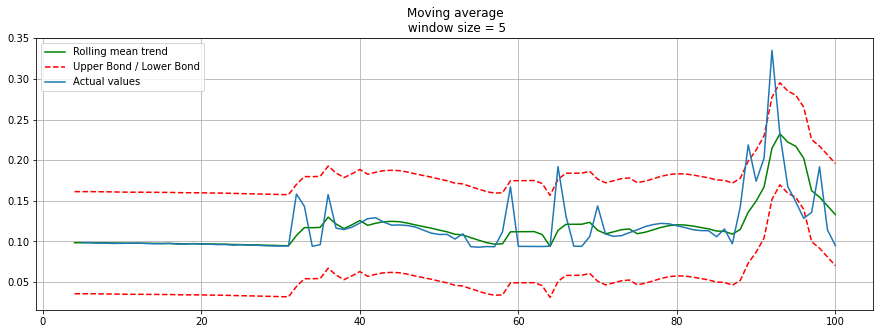

In [61]:
for i in df_std.columns[6:].tolist():
    try:
        udf_ts.plotMovingAverage(df_std.groupby('progress_perc')[i].mean(), 5, plot_intervals=True)
    except:
        print('Error occured for: ', i)